## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import numpy as np
import cv2
import glob
import pickle
import matplotlib.pyplot as plt
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

In [2]:
def show_couple(img1, img2, title1=None, title2=None):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    if len(img1.shape) <= 2:
        ax1.imshow(img1, cmap='gray')
    else:
        ax1.imshow(img1)
    if title1:
        ax1.set_title(title1, fontsize=50)

    if len(img2.shape) <= 2:
        ax2.imshow(img2, cmap='gray')
    else:
        ax2.imshow(img2)
    if title2:
        ax2.set_title(title2, fontsize=50)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

## Calibrate Camera

In [3]:
def call_undistort(img, objpoints, imgpoints):
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

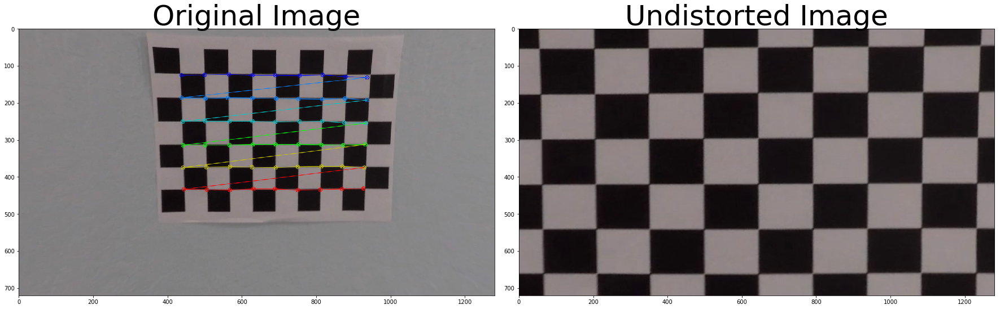

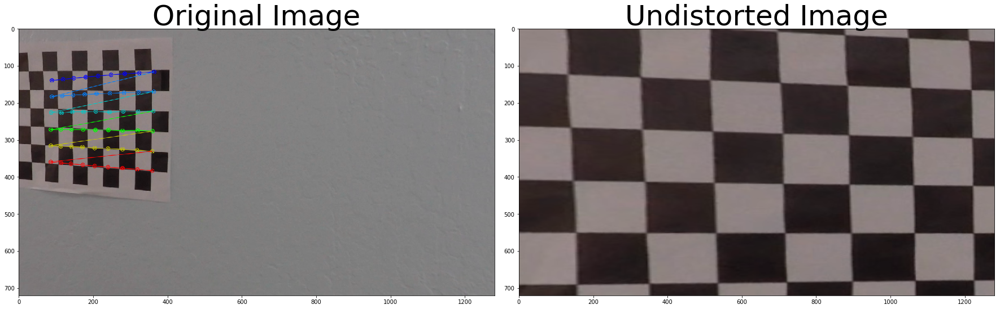

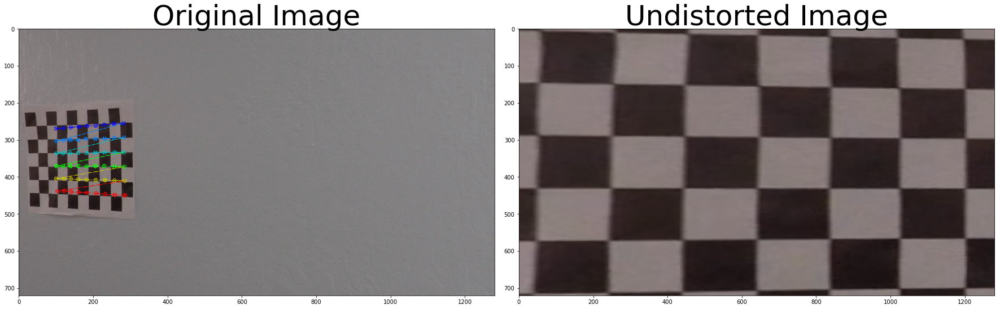

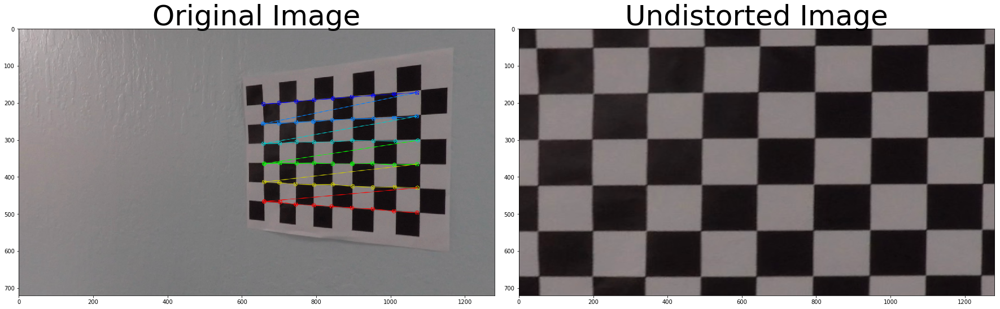

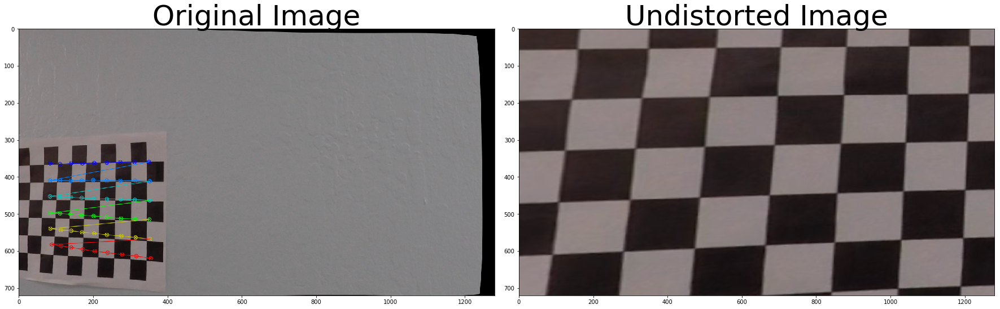

...

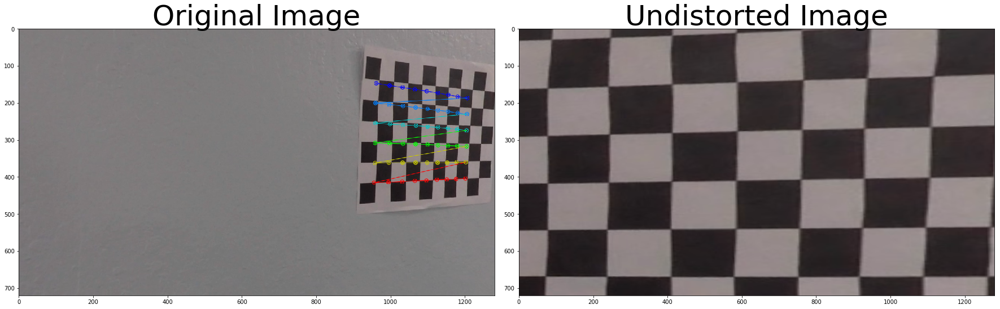

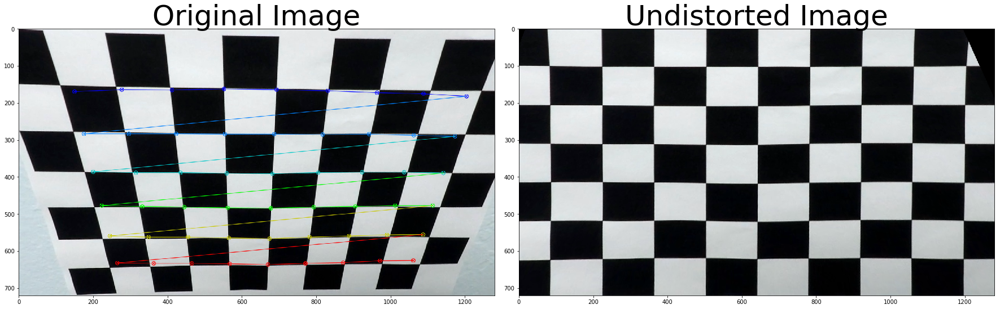

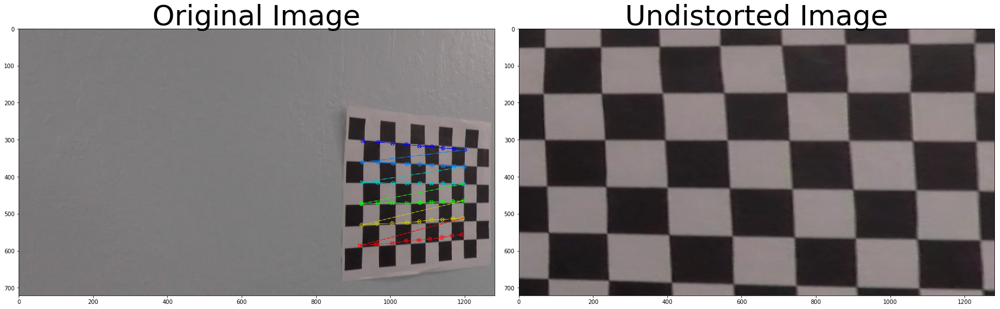

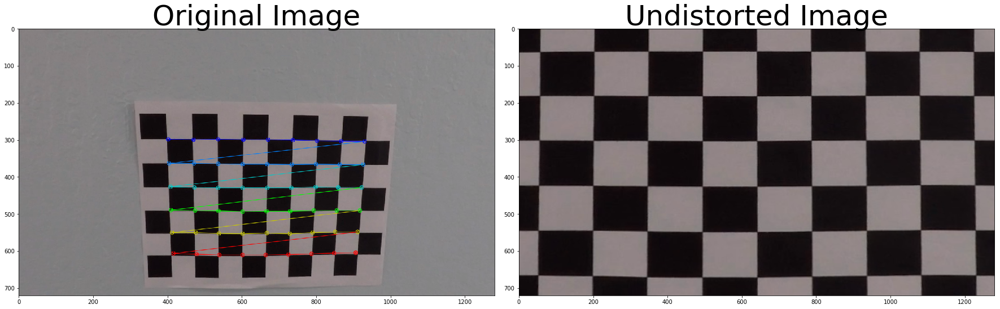

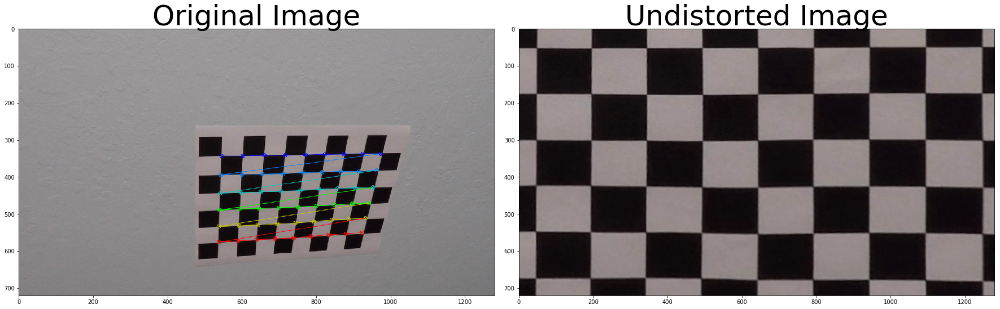

In [4]:
nx = 9 # the number of insicall_undistortde corners in x
ny = 6 # the number of inside corners in y

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        undist = call_undistort(img, objpoints, imgpoints)
        undist2 = np.copy(undist)
        
        # Draw and display the corners
        drawn = cv2.drawChessboardCorners(undist, (nx,ny), corners, ret)
        
        total = nx * ny
        src = np.float32([corners[0][0], corners[nx-1][0], corners[total - nx][0], corners[total -1][0]])
        
        box_h = corners[nx][0][1] - corners[0][0][1]
        d_sh = img.shape[1::-1]
        dst = np.float32([[box_h,box_h],[d_sh[0] - box_h,box_h],[box_h,d_sh[1] - box_h],[d_sh[0] - box_h,d_sh[1] - box_h]])
        
        M = cv2.getPerspectiveTransform(src, dst)
        warped = cv2.warpPerspective(undist2, M, img.shape[1::-1], flags=cv2.INTER_LINEAR)
        
        show_couple(drawn, warped, 'Original Image', 'Undistorted Image')

### Compute Calibration

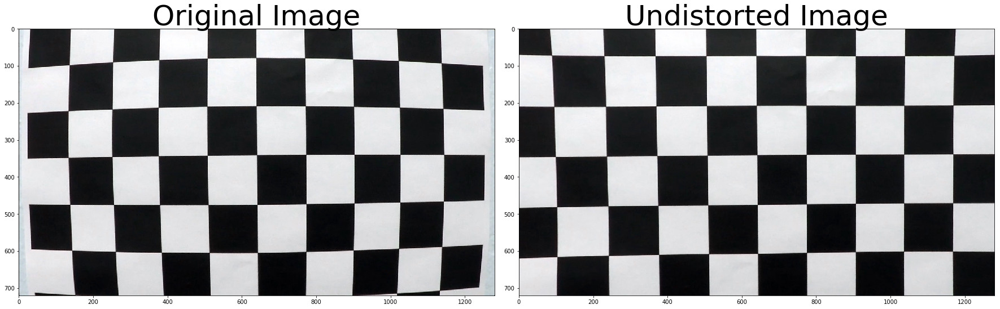

In [5]:
img = cv2.imread('./camera_cal/calibration1.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
undist = cv2.undistort(img, mtx, dist, None, mtx)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
calibration = {"mtx" : mtx, "dist": dist}
pickle.dump(calibration, open( "calibration.p", "wb" ) )

# Visualize undistortion
show_couple(img, undist, 'Original Image', 'Undistorted Image')

## Test Images

### Undistort images

In [6]:
def undistort(img):
    return cv2.undistort(img, mtx, dist, None, mtx)

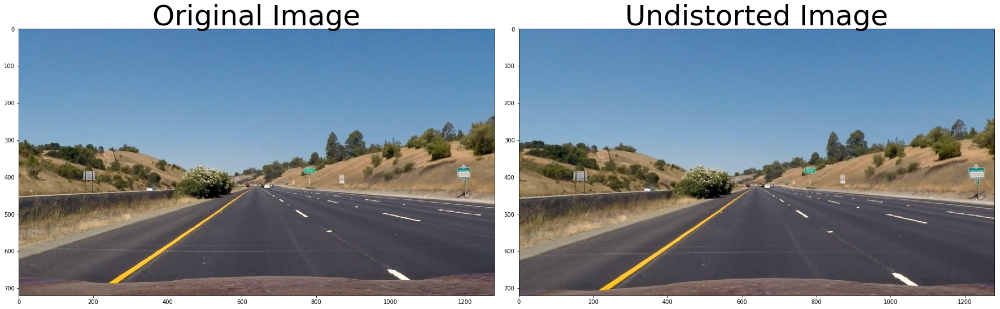

In [7]:
test = {}
test['img'] = cv2.imread('./test_images/straight_lines1.jpg')
test['img'] = cv2.cvtColor(test['img'],cv2.COLOR_BGR2RGB)
test['dst'] = undistort(test['img'])

show_couple(test['img'], test['dst'], 'Original Image', 'Undistorted Image')

### Perspective Transform

In [8]:
def unwarp(img, src, dst):
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img.shape[1::-1], flags=cv2.INTER_LINEAR)
    return warped, M, Minv

In [9]:
shp = test['dst'].shape[1::-1]
src = np.float32([
    [580, 450], 
    [shp[0] - 500, 450], 
    [shp[0] - 90, shp[1]-55],
    [150, shp[1]-55],
])
dst = np.float32([[0,0],[shp[0],0],[shp[0], shp[1]],[0,shp[1]]])

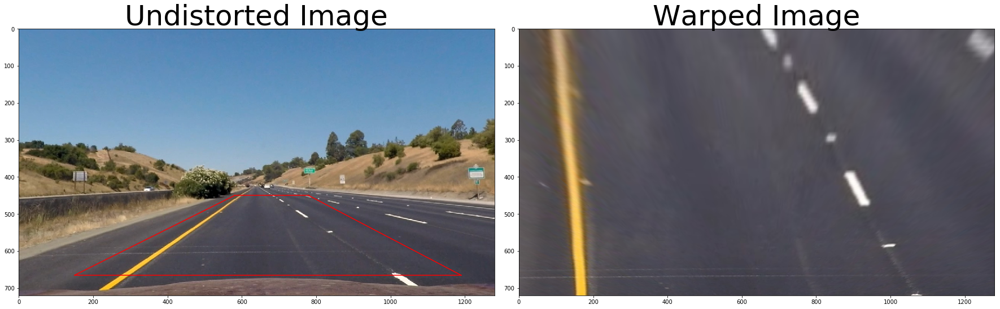

In [10]:
test['wrp'], test['M'], test['Mi'] = unwarp(test['dst'], src, dst)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(test['dst'])
for i in range(4):
    j = (i + 1) % 4
    ax1.plot((src[i][0], src[j][0]), (src[i][1], src[j][1]), color="red")
ax1.set_title('Undistorted Image', fontsize=50)

ax2.imshow(test['wrp'])
ax2.set_title('Warped Image', fontsize=50)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

### Sobel Absolute Threshold

In [11]:
# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
def abs_sobel_thresh(img, orient='x', thresh_min=25, thresh_max=255):
    # Apply the following steps to img
    # 1) Convert to grayscale === or LAB L channel
    gray = (cv2.cvtColor(img, cv2.COLOR_RGB2Lab))[:,:,0]
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobel = cv2.Sobel(gray, cv2.CV_64F, orient=='x', orient=='y')
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    return sxbinary

Text(0.5,1,'Sobel Absolute')

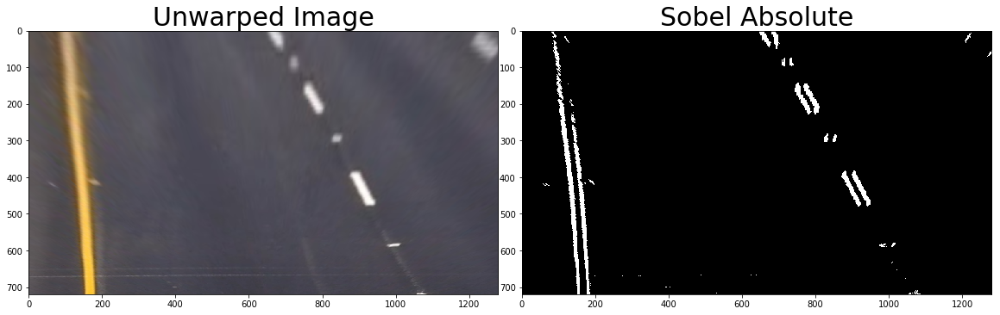

In [12]:
test['sbl'] = abs_sobel_thresh(test['wrp'], 'x', 25, 255)
# Visualize sobel absolute threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(test['wrp'])
ax1.set_title('Unwarped Image', fontsize=30)
ax2.imshow(test['sbl'], cmap='gray')
ax2.set_title('Sobel Absolute', fontsize=30)


### Sobel Magnitude Threshold

In [13]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def mag_thresh(img, kernel=25, thresh=(25, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, kernel)
    # 3) Calculate the magnitude 
    mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    # 5) Create a binary mask where mag thresholds are met
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return sxbinary

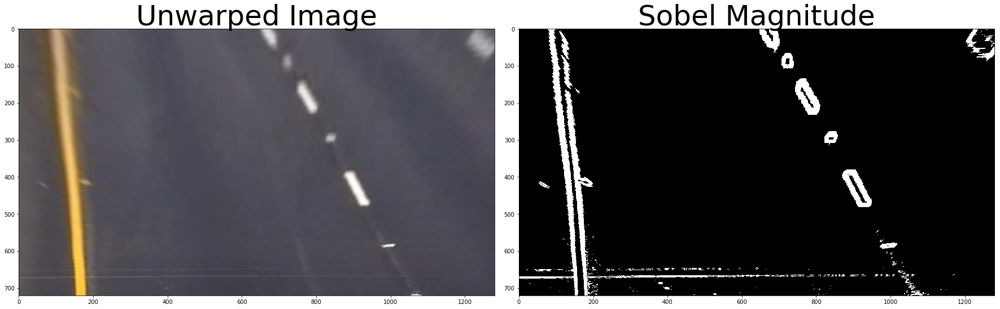

In [14]:
test['mag'] = mag_thresh(test['wrp'], kernel=31, thresh=(10, 255))
# Visualize sobel magnitude threshold
show_couple(test['wrp'], test['mag'], 'Unwarped Image', 'Sobel Magnitude')

### Sobel Direction Threshold

In [15]:
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_thresh(img, kernel=7, thresh=(0, 0.09)):    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    grad_dir = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    binary_output =  np.zeros_like(grad_dir)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

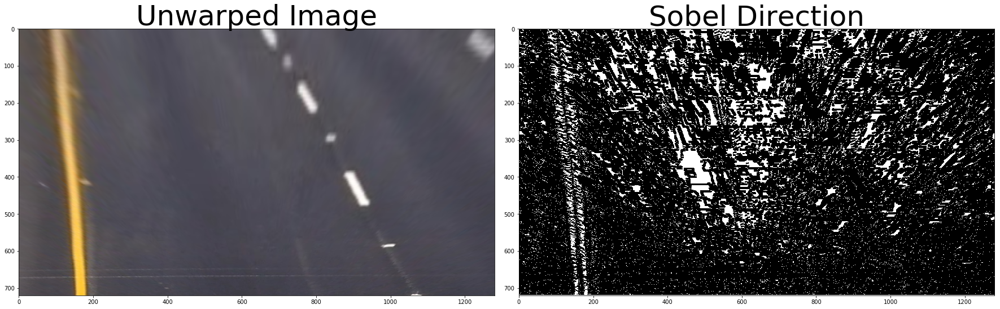

In [16]:
test['dir'] = dir_thresh(test['wrp'], kernel=7, thresh=(0, 0.09))
# Visualize sobel direction threshold
show_couple(test['wrp'], test['dir'], 'Unwarped Image', 'Sobel Direction')

### Sobel Magnitude & Direction Threshold

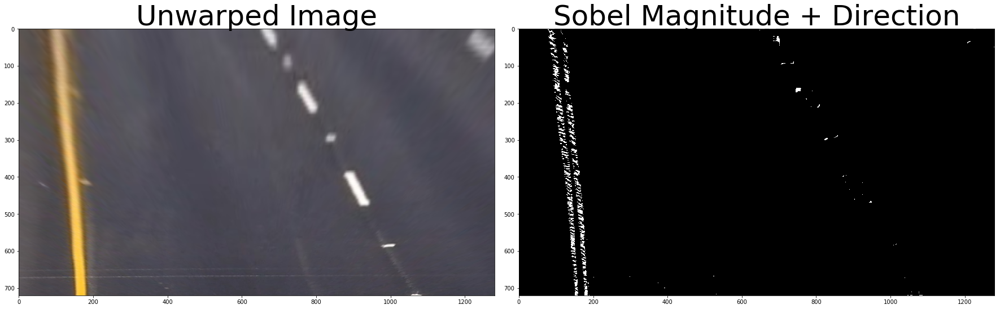

In [17]:
test['m+d'] = np.zeros_like(test['mag'])
test['m+d'][((test['mag'] == 1) & (test['dir'] == 1))] = 1
# Visualize sobel magnitude + direction threshold
show_couple(test['wrp'], test['m+d'], 'Unwarped Image', 'Sobel Magnitude + Direction')

### HLS Colorspace S-Channel Threshold

In [18]:
# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_s_thresh(img, thresh=(125, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    binary_output = np.zeros_like(hls[:,:,2])
    binary_output[(hls[:,:,2] > thresh[0]) & (hls[:,:,2] <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary_output

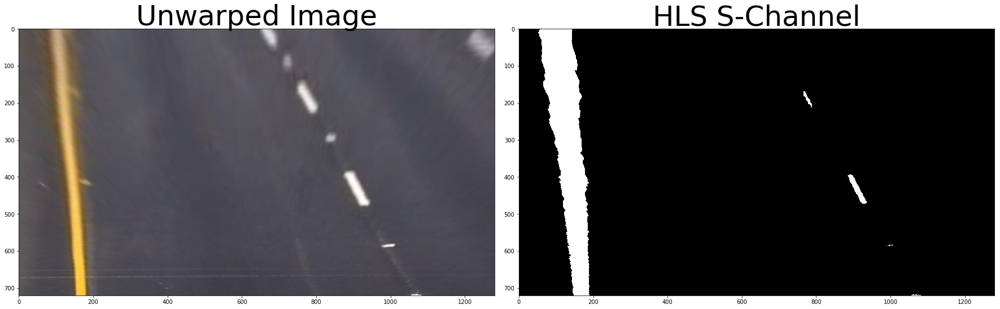

In [19]:
test['hlS'] = hls_s_thresh(test['wrp'], (40, 255))
show_couple(test['wrp'], test['hlS'], "Unwarped Image", "HLS S-Channel")

### HLS Colorspace L-Channel

In [20]:
# Define a function that thresholds the L-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_l_thresh(img, thresh=(220, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    hls_l = hls[:,:,1]
    hls_l = hls_l*(255/np.max(hls_l))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(hls_l)
    binary_output[(hls_l > thresh[0]) & (hls_l <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary_output

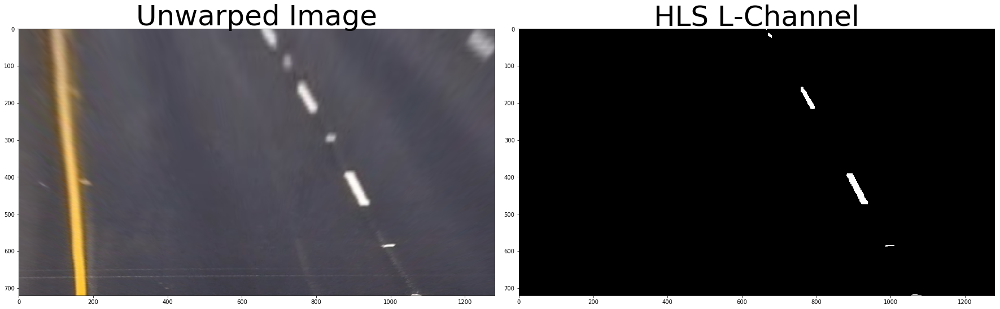

In [21]:
test['hLs'] = hls_l_thresh(test['wrp'], (220, 255))
show_couple(test['wrp'], test['hLs'], "Unwarped Image", "HLS L-Channel")

### LAB Colorspace B-Channel

In [22]:
# Define a function that thresholds the B-channel of LAB
# Use exclusive lower bound (>) and inclusive upper (<=), OR the results of the thresholds (B channel should capture
# yellows)
def lab_b_thresh(img, thresh=(190, 255)):
    # 1) Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    lab_b = lab[:,:,2]
    # don't normalize if there are no yellows in the image
    if np.max(lab_b) > 175:
        lab_b = lab_b*(255/np.max(lab_b))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(lab_b)
    binary_output[((lab_b > thresh[0]) & (lab_b <= thresh[1]))] = 1
    # 3) Return a binary image of threshold result
    return binary_output

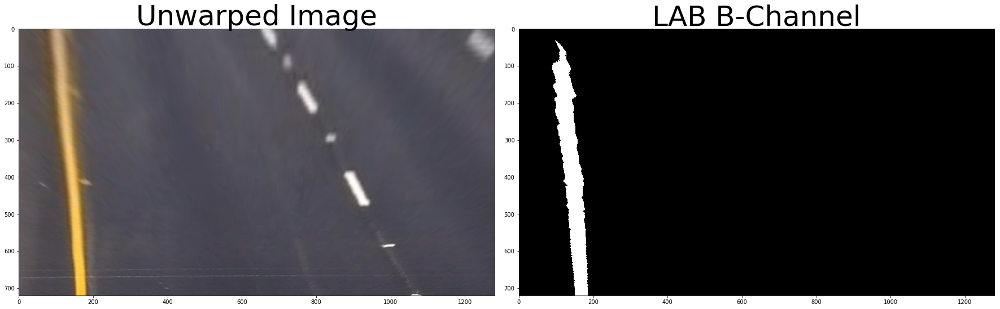

In [23]:
test['laB'] = lab_b_thresh(test['wrp'], (190, 255))
show_couple(test['wrp'], test['laB'], "Unwarped Image", "LAB B-Channel")

### HLS L-Channel + LAB B-Channel

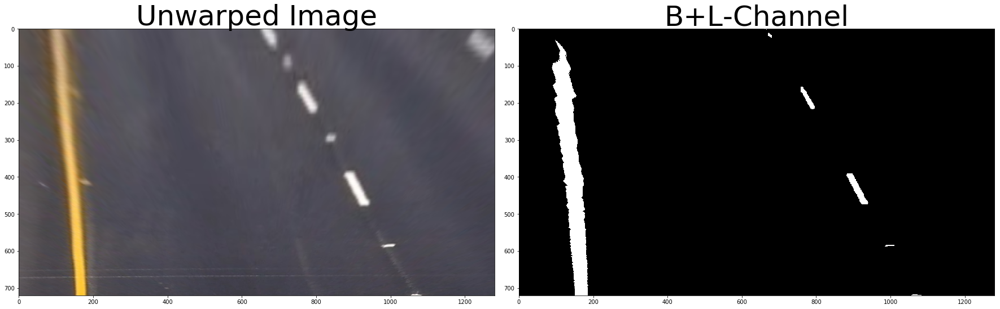

In [24]:
test['l+b'] = np.zeros_like(test['laB'])
test['l+b'][(test['hLs'] == 1) | (test['laB'] == 1)] = 1
show_couple(test['wrp'], test['l+b'], "Unwarped Image", "B+L-Channel")

### HLS L-Channel + LAB B-Channel + Sobel Magnitude

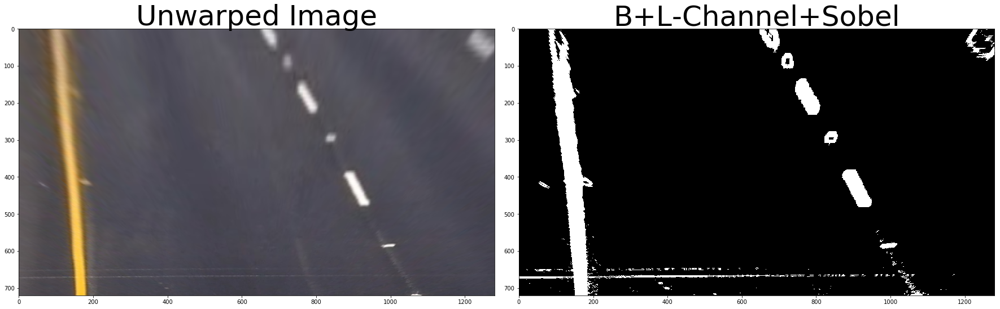

In [109]:
test['l+b+m'] = np.zeros_like(test['laB'])
test['l+b+m'][(test['hLs'] == 1) | (test['laB'] == 1) | (test['mag'] == 1)] = 1
show_couple(test['wrp'], test['l+b+m'], "Unwarped Image", "B+L-Channel+Sobel")

### Pipeline

In [116]:
def pipeline(img):
    img_dst = undistort(img)
    img_wrp, img_M, img_Minv = unwarp(img_dst, src, dst)
    img_hLs = hls_l_thresh(img_wrp)
    img_laB = lab_b_thresh(img_wrp)
    img_mag = mag_thresh(img_wrp, kernel=31, thresh=(30, 255))
    img_abs = abs_sobel_thresh(img_wrp, 'x', 25, 255)
    img_bin = np.zeros_like(img_laB)
    img_bin[(img_hLs == 1) | (img_laB == 1) | (img_abs == 1)] = 1
    return img_bin, img_Minv

### Run pipeline on test images

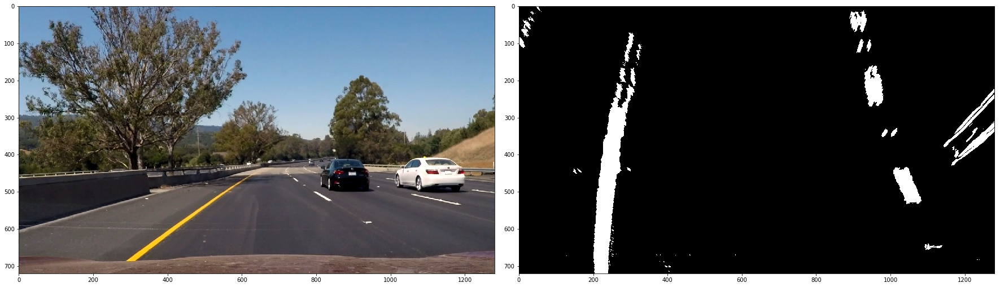

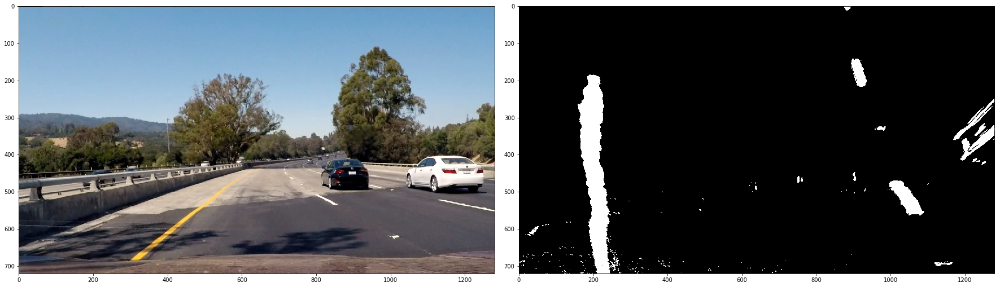

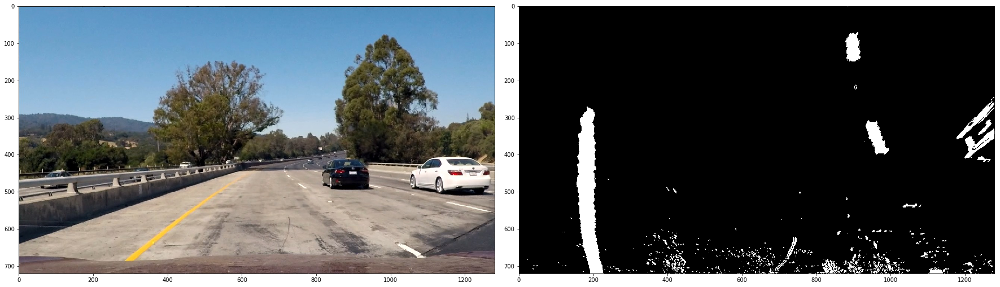

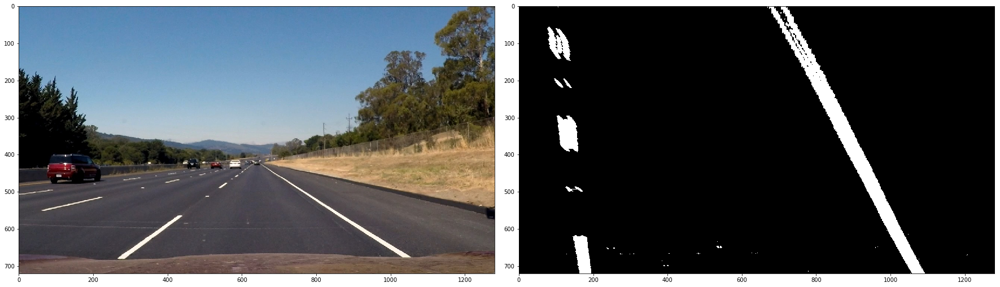

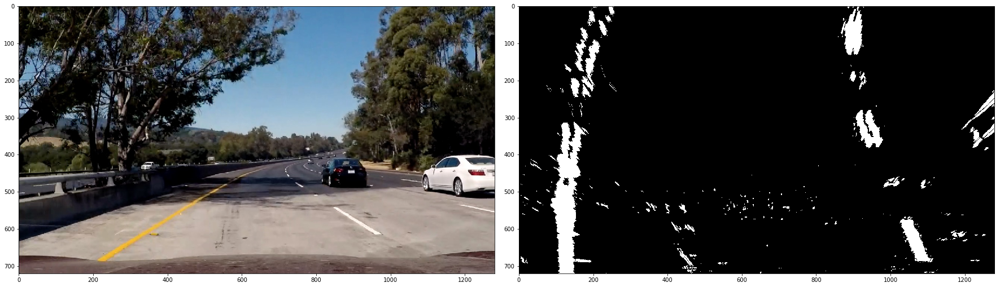

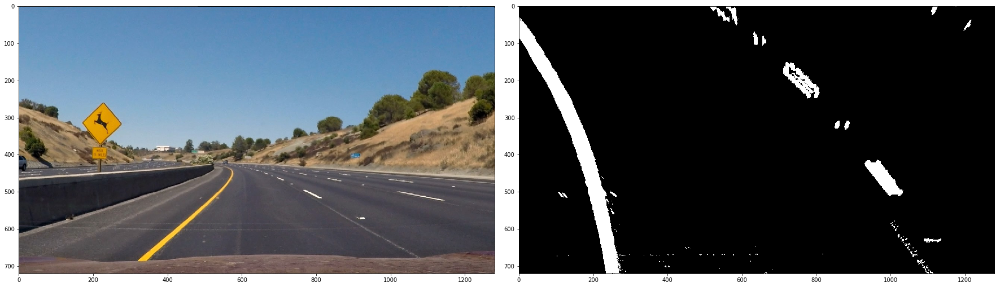

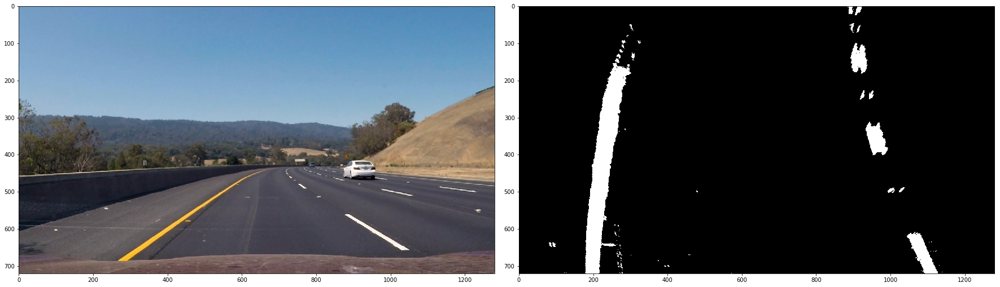

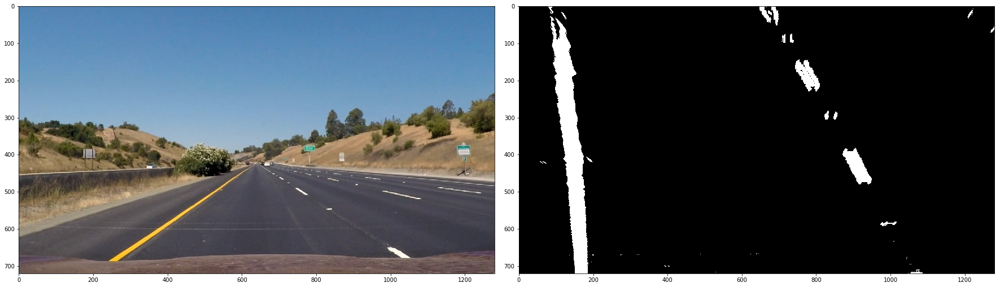

In [117]:
image_paths = glob.glob('./test_images/*.jpg')

images = []

for img_path in image_paths:
    image = {}
    image['img'] = cv2.imread(img_path)
    image['img'] = cv2.cvtColor(image['img'], cv2.COLOR_BGR2RGB)
    image['bin'], image['Minv'] = pipeline(image['img'])
    show_couple(image['img'], image['bin'])
    images.append(image)

### Sliding Window

In [39]:
def sliding_window(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    quarter_point = np.int(midpoint//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    #leftx_base = np.argmax(histogram[quarter_point:midpoint]) + quarter_point
    #rightx_base = np.argmax(histogram[midpoint:(midpoint+quarter_point)]) + midpoint
    
    
    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 120
    # Set minimum number of pixels found to recenter window
    minpix = 20
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high), (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    # Generate x and y values for plotting
    left_fit, right_fit = None, None
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)

    return (left_lane_inds, right_lane_inds), (left_fit, right_fit), out_img

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


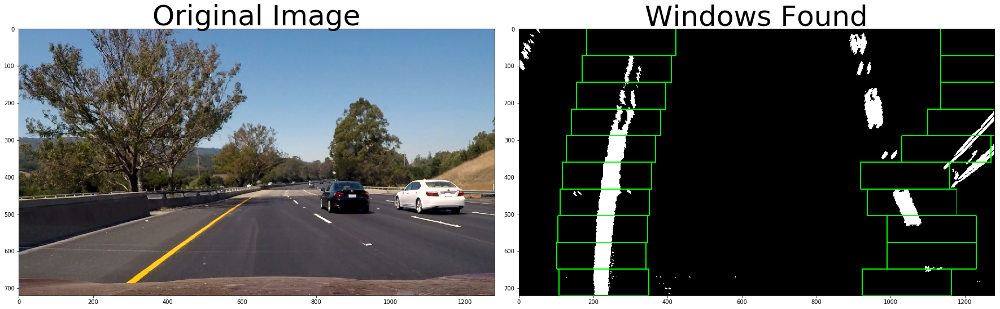

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


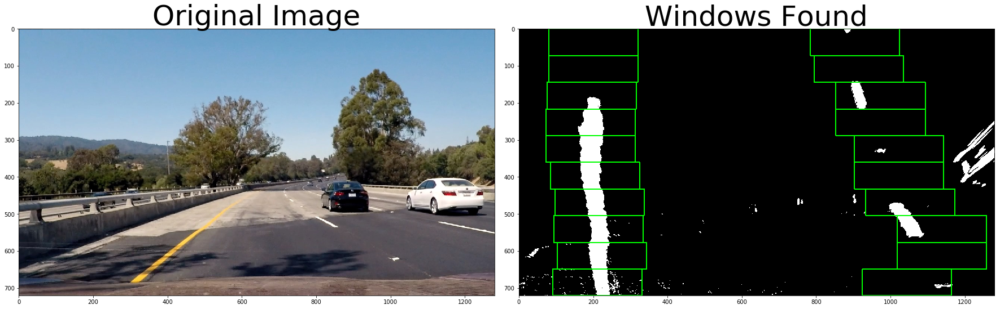

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


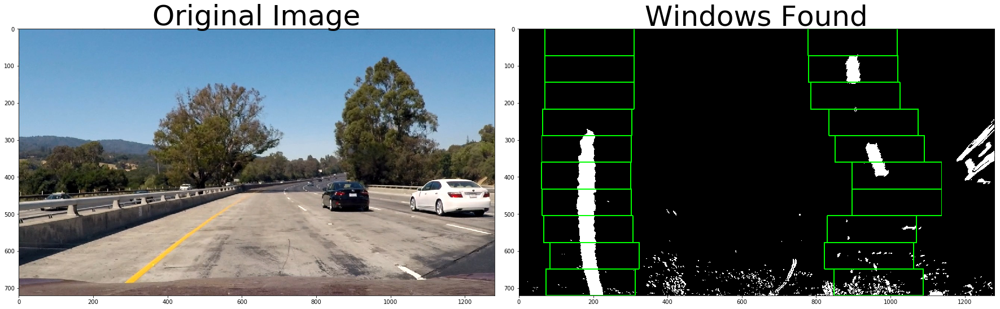

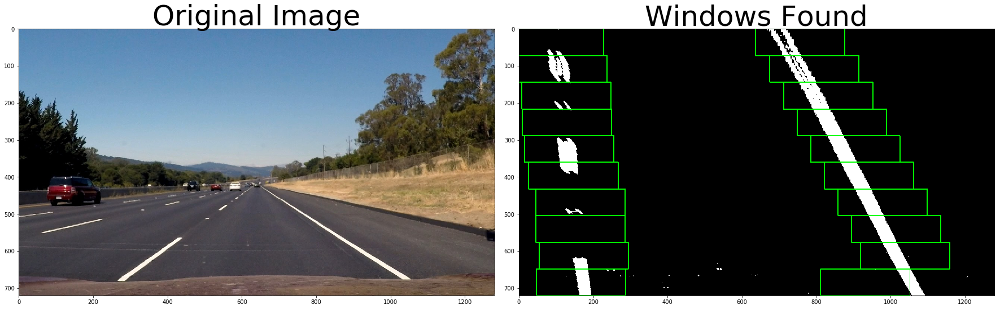

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


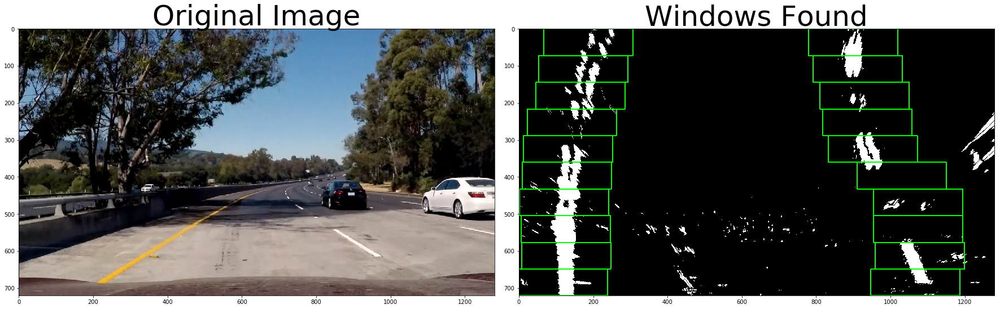

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


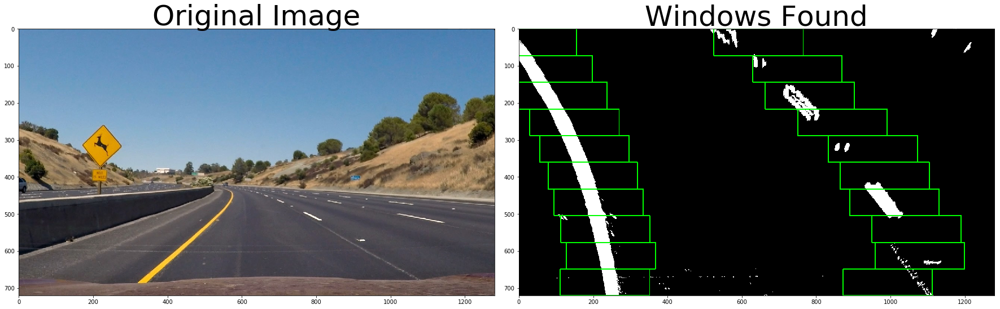

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


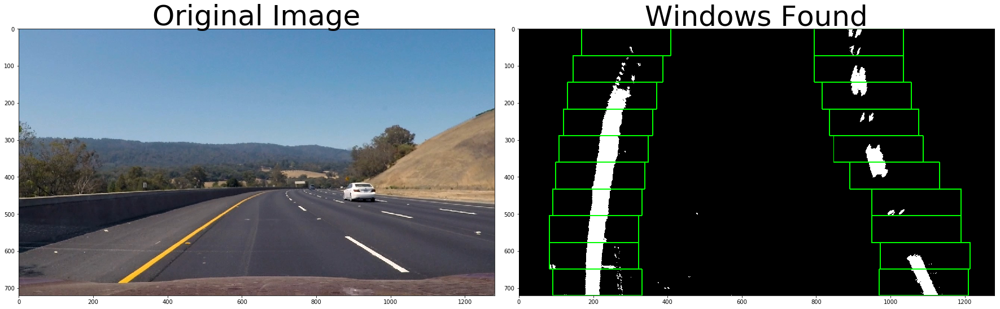

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


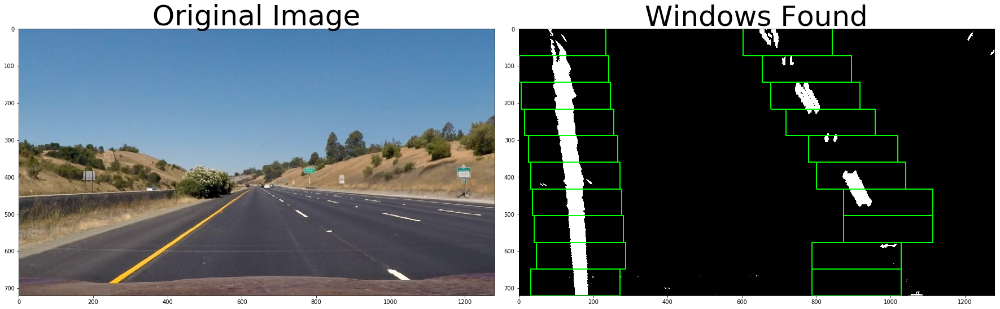

In [118]:
for image in images:
    image['lin'], image['fit'], image['wnd'] = sliding_window(image['bin'])
    show_couple(image['img'], image['wnd'], "Original Image", "Windows Found")   

#### Visualize lines drawn

In [41]:
def visualize(image_bin, lin, fit):
    margin = 80
    
    nonzero = image_bin.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((image_bin, image_bin, image_bin)) * 255
    window_img = np.zeros_like(out_img)
    
    ploty = np.linspace(0, image_bin.shape[0]-1, image_bin.shape[0])
    
    # Color in left and right line pixels
    out_img[nonzeroy[lin[0]], nonzerox[lin[0]]] = [255, 0, 0]
    out_img[nonzeroy[lin[1]], nonzerox[lin[1]]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_fit = fit[0]
    right_fit = fit[1]
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin,ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0), lineType=cv2.LINE_AA)
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0), lineType=cv2.LINE_AA)
    
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


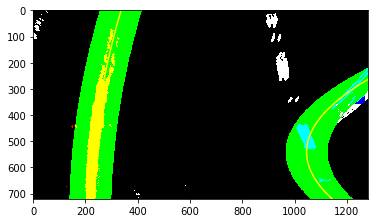

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


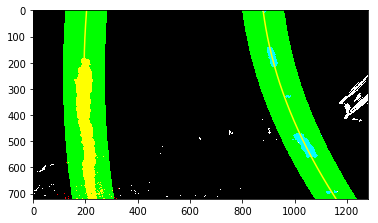

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


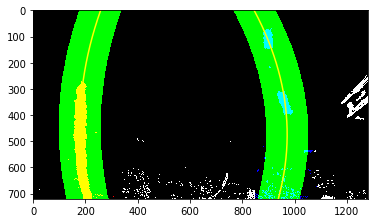

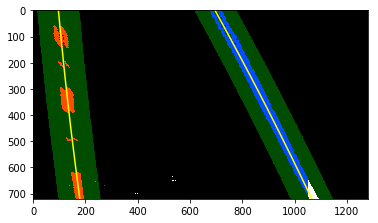

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


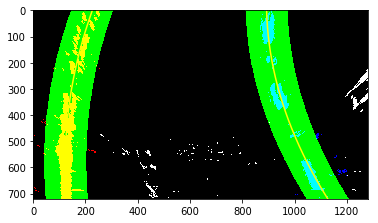

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


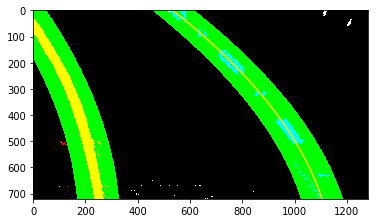

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


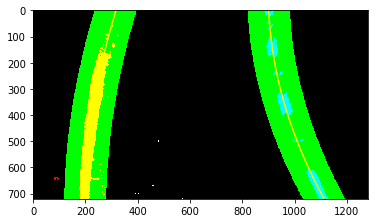

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


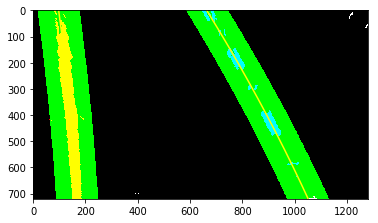

In [119]:
for image in images:
    visualize(image['bin'], image['lin'], image['fit'])

### PolyFit with prior knowledge

In [43]:
def polyfit(binary_warped, left_fit_prev, right_fit_prev):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    margin = 100
    left_lane_inds = ((nonzerox > (left_fit_prev[0]*(nonzeroy**2) + left_fit_prev[1]*nonzeroy + 
                       left_fit_prev[2] - margin)) & (nonzerox < (left_fit_prev[0]*(nonzeroy**2) + 
                       left_fit_prev[1]*nonzeroy + left_fit_prev[2] + margin)))

    right_lane_inds = ((nonzerox > (right_fit_prev[0]*(nonzeroy**2) + right_fit_prev[1]*nonzeroy + 
                        right_fit_prev[2] - margin)) & (nonzerox < (right_fit_prev[0]*(nonzeroy**2) + 
                        right_fit_prev[1]*nonzeroy + right_fit_prev[2] + margin)))

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    
    left_fit, right_fit = None, None
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    
    return (left_lane_inds, right_lane_inds), (left_fit, right_fit)

### Radius of Curvature and Distance from Lane Center Calculation

In [44]:
# Method to determine radius of curvature and distance from lane center 
# based on binary image, polynomial fit, and L and R lane pixel indices
def curvature_distance(bin_img, fit_l, fit_r, lin_l, lin_r):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    rad_l, rad_r, center_dist = (0, 0, 0)
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    h = bin_img.shape[0]
    ploty = np.linspace(0, h-1, h)
    y_eval = np.max(ploty)
  
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = bin_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Again, extract left and right line pixel positions
    leftx = nonzerox[lin_l]
    lefty = nonzeroy[lin_l] 
    rightx = nonzerox[lin_r]
    righty = nonzeroy[lin_r]
    
    if len(leftx) != 0:
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        rad_l = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])

    if len(rightx) != 0:
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        rad_r = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Distance from center is image x midpoint - mean of fit_l and fit_r intercepts 
    if fit_l is not None and fit_r is not None:
        fit_l_x_int = fit_l[0]*h**2 + fit_l[1]*h + fit_l[2]
        fit_r_x_int = fit_r[0]*h**2 + fit_r[1]*h + fit_r[2]
        car_position = bin_img.shape[1]/2
        lane_center_position = (fit_r_x_int + fit_l_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    
    return (rad_l, rad_r), center_dist

In [45]:
for image in images:
    image['rad'], image['cnt'] = curvature_distance(image['bin'], image['fit'][0], image['fit'][1], image['lin'][0], image['lin'][1])
    print('Radius of curvature for example:', image['rad'][0], 'm,', image['rad'][1], 'm')
    print('Distance from lane center for example:', image['cnt'], 'm')

Radius of curvature for example: 849.1023651302139 m, 592.9183389211777 m
Distance from lane center for example: -0.2543613822697048 m
Radius of curvature for example: 1072.0561329592101 m, 412.5999175321559 m
Distance from lane center for example: -0.2938729459179073 m
Radius of curvature for example: 460.82293306139695 m, 316.0919027683848 m
Distance from lane center for example: -0.2695307269281423 m
Radius of curvature for example: 4135.477742920791 m, 14428.844352020022 m
Distance from lane center for example: 0.08209687051628399 m
Radius of curvature for example: 407.6235821803567 m, 502.43017633400285 m
Distance from lane center for example: 0.09795872561610147 m
Radius of curvature for example: 377.03834896341147 m, 909.1140496298019 m
Distance from lane center for example: -0.4101089029204966 m
Radius of curvature for example: 926.6292313640148 m, 487.6170084594879 m
Distance from lane center for example: -0.07709480395633503 m
Radius of curvature for example: 4972.54758251740

### Draw the Detected Lane Back onto the Original Image

In [99]:
def draw_lane(original_img, binary_img, Minv, left_fit, right_fit):
    if left_fit is None or right_fit is None:
        return original_img
    new_img = np.copy(original_img)
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0])
    
    h, w = binary_img.shape
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (184,225, 255))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, newwarp, 0.5, 0)
    return result

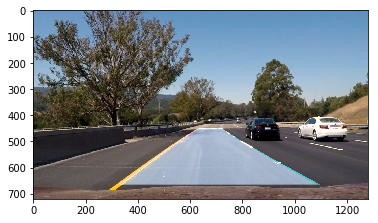

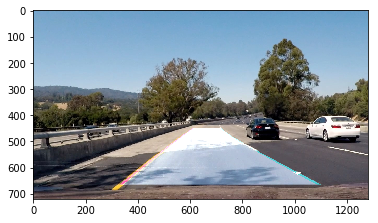

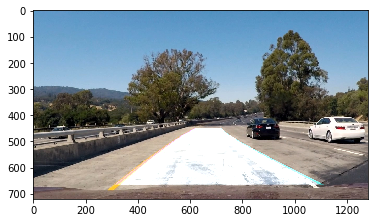

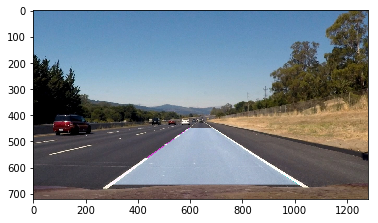

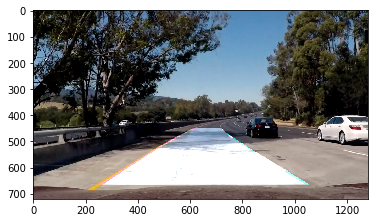

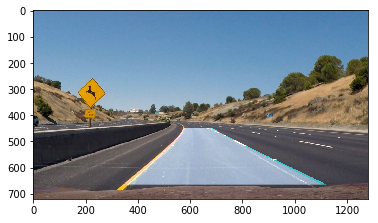

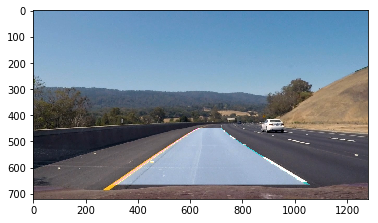

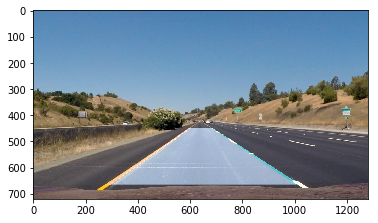

In [100]:
for image in images:
    image['drn'] = draw_lane(image['img'], image['bin'], image['Minv'], image['fit'][0], image['fit'][1])
    plt.imshow(image['drn'])
    plt.show()

### Draw Curvature Radius and Center Distance onto the Original Image

In [48]:
def draw_data(original_img, curv_rad, center_dist):
    new_img = np.copy(original_img)
    h = new_img.shape[0]
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curv_rad) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return new_img

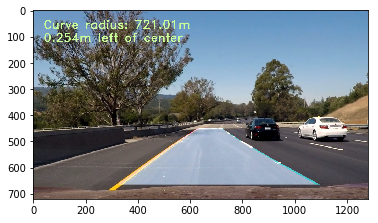

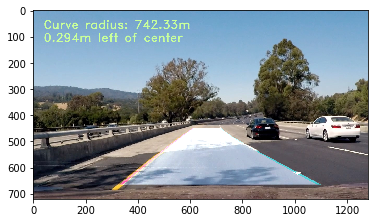

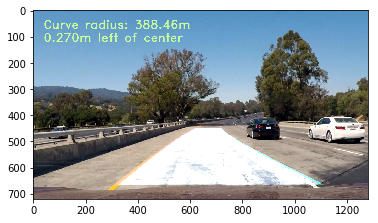

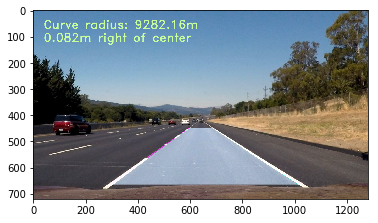

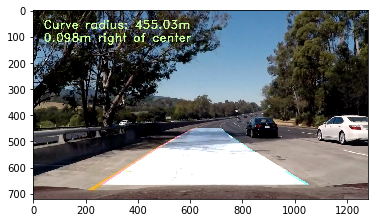

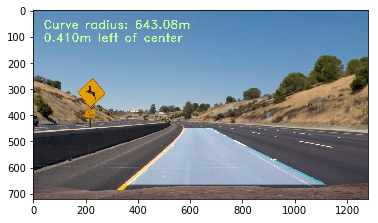

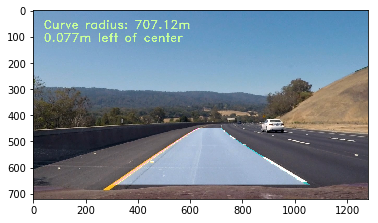

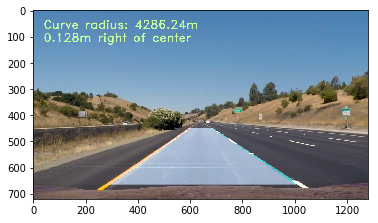

In [101]:
for image in images:
    image['fnl'] = draw_data(image['drn'], (image['rad'][0] + image['rad'][1])/2, image['cnt'])
    plt.imshow(image['fnl'])
    plt.show()

## Video Pipeline

### Definitions

In [103]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
    def sanity_check(self, R1):
        if self.radius_of_curvature is None:
            return True
        R0 = self.radius_of_curvature
        return abs(R1-R0)/R0 <= 0.85
        
    
    def add_fit(self, fit, inds, rad):
        if fit is not None:
            if self.best_fit is not None:
                # if we have a best fit, see how this new fit compares
                self.diffs = abs(fit-self.best_fit)
            self.detected = ((self.diffs[0] <= 0.001 and self.diffs[1] <= 1.0 and self.diffs[2] <= 100.) 
                                or len(self.current_fit) == 0) and self.sanity_check(rad)
            if self.detected:
                self.radius_of_curvature = rad
                self.current_fit.append(fit)
                if len(self.current_fit) > 5:
                    # throw out old fits, keep newest n
                    self.current_fit = self.current_fit[1:]
                self.best_fit = np.average(self.current_fit, axis=0)
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                # throw out oldest fit
                self.current_fit = self.current_fit[:len(self.current_fit)-1]
            if len(self.current_fit) > 0:
                # if there are still any fits in the queue, best_fit is their average
                self.best_fit = np.average(self.current_fit, axis=0)

### Pipeline

In [120]:
def process(img):
    new_img = np.copy(img)
    img_bin, Minv = pipeline(new_img)
    
    if not l_line.detected or not r_line.detected:
        lin, fit, _ = sliding_window(img_bin)
    else:
        lin, fit = polyfit(img_bin, l_line.best_fit, r_line.best_fit)
    rad, d_center = curvature_distance(img_bin, fit[0], fit[1], lin[0], lin[1])
    
    if abs(rad[0] - rad[1]) < 300:
        l_line.add_fit(fit[0], lin[0], rad[0])
        r_line.add_fit(fit[1], lin[1], rad[1])
    
    # draw the current best fit if it exists
    if l_line.best_fit is not None and r_line.best_fit is not None:
        img_out1 = draw_lane(new_img, img_bin, Minv, l_line.best_fit, r_line.best_fit)
        img_out = draw_data(img_out1, (rad[0]+rad[1])/2, d_center)
    else:
        img_out = new_img
    return img_out

### Process

In [121]:
l_line = Line()
r_line = Line()

video_out = 'project_video_output.mp4'
video_in = VideoFileClip('project_video.mp4')
processed_video = video_in.fl_image(process)
%time processed_video.write_videofile(video_out, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [04:14<00:00,  4.96it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 30min 11s, sys: 32.3 s, total: 30min 44s
Wall time: 4min 15s


In [123]:
l_line = Line()
r_line = Line()

video_out = 'challenge_video_output.mp4'
video_in = VideoFileClip('challenge_video.mp4')
processed_video = video_in.fl_image(process)
%time processed_video.write_videofile(video_out, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [01:32<00:00,  5.24it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 11min 1s, sys: 12.1 s, total: 11min 14s
Wall time: 1min 33s


In [71]:
l_line = Line()
r_line = Line()

video_out = 'harder_challenge_video_output.mp4'
video_in = VideoFileClip('harder_challenge_video.mp4')
processed_video = video_in.fl_image(process)
%time processed_video.write_videofile(video_out, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [03:58<00:00,  5.03it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 27min 37s, sys: 30.5 s, total: 28min 8s
Wall time: 3min 59s
